In [1]:
import pandas as pd

crime = pd.read_csv('crime.csv')

covid_weekly = pd.read_csv('covid_weekly.csv')


In [2]:
crime.head(2)


,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,updated_on,latitude,longitude,location,only_date,Zip Code,week_start,week_end,total_crime_count_for_zip
0,11847685,JC456673,2019-10-02,040XX W LAWRENCE AVE,0860,THEFT,RETAIL THEFT,SMALL RETAIL STORE,False,False,1712,2019-10-09T15:46:53.000,41.968235,-87.728572,"{'latitude': '41.968234567', 'longitude': '-87...",2019-10-02,60630,2019-09-29,2019-10-05,13731
1,11848492,JC457609,2019-10-02,014XX N ELK GROVE AVE,0610,BURGLARY,FORCIBLE ENTRY,RESIDENCE,False,False,1424,2019-10-09T15:46:53.000,41.908966,-87.673452,"{'latitude': '41.908965963', 'longitude': '-87...",2019-10-02,60622,2019-09-29,2019-10-05,24879


In [3]:
crime.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1374268 entries, 0 to 1374267
Data columns (total 20 columns):
 #   Column                     Non-Null Count    Dtype  
---  ------                     --------------    -----  
 0   id                         1374268 non-null  int64  
 1   case_number                1374268 non-null  object 
 2   date                       1374268 non-null  object 
 3   block                      1374268 non-null  object 
 4   iucr                       1374268 non-null  object 
 5   primary_type               1374268 non-null  object 
 6   description                1374268 non-null  object 
 7   location_description       1368845 non-null  object 
 8   arrest                     1374268 non-null  bool   
 9   domestic                   1374268 non-null  bool   
 10  beat                       1374268 non-null  int64  
 11  updated_on                 1374268 non-null  object 
 12  latitude                   1374268 non-null  float64
 13  longitude   

In [4]:
crime = crime[['id', 'case_number', 'date', 'block', 'iucr', 'primary_type',
       'description', 'location_description', 'arrest', 'domestic', 'beat',
       'updated_on', 'latitude', 'longitude',
       'location','only_date', 'Zip Code', 'week_start', 'week_end',
       'total_crime_count_for_zip']]
# Keep Important columns only       

In [5]:
crime.drop_duplicates(inplace=True,ignore_index=True)

In [6]:
# Find duplicate rows based on the 'id' column
duplicate_rows = crime[crime.duplicated(subset=['id','case_number','date'], keep=False)]

# Print the duplicate rows
duplicate_rows


,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,updated_on,latitude,longitude,location,only_date,Zip Code,week_start,week_end,total_crime_count_for_zip
342870,13419439,JH213160,2024-04-05,023XX N GREENVIEW AVE,3731,INTERFERENCE WITH PUBLIC OFFICER,OBSTRUCTING IDENTIFICATION,STREET,True,False,1811,2024-04-13T15:41:04.000,41.924221,-87.665766,"{'latitude': '41.924220605', 'longitude': '-87...",2024-04-05,60614,2024-03-31,2024-04-06,16925
342981,13419355,JH213024,2024-04-04,043XX N HAZEL ST,0281,CRIMINAL SEXUAL ASSAULT,NON-AGGRAVATED,STREET,False,False,1915,2024-04-12T15:42:34.000,41.961158,-87.652309,"{'latitude': '41.961158296', 'longitude': '-87...",2024-04-04,60613,2024-03-31,2024-04-06,19988
343178,13418947,JH212707,2024-04-04,062XX S STONY ISLAND AVE,0460,BATTERY,SIMPLE,SCHOOL - PUBLIC GROUNDS,False,False,314,2024-04-12T15:42:34.000,41.782080,-87.586502,"{'latitude': '41.782079568', 'longitude': '-87...",2024-04-04,60637,2024-03-31,2024-04-06,36654
1372284,13418947,JH212707,2024-04-04,062XX S STONY ISLAND AVE,0460,BATTERY,SIMPLE,SCHOOL - PUBLIC GROUNDS,True,False,314,2024-04-19T15:40:18.000,41.782080,-87.586502,"{'latitude': '41.782079568', 'longitude': '-87...",2024-04-04,60637,2024-03-31,2024-04-06,36654
1372285,13419355,JH213024,2024-04-04,009XX W MONTROSE AVE,0281,CRIMINAL SEXUAL ASSAULT,NON-AGGRAVATED,STREET,False,False,1914,2024-04-20T15:40:43.000,41.961800,-87.653156,"{'latitude': '41.961799968', 'longitude': '-87...",2024-04-04,60613,2024-03-31,2024-04-06,19988
1372286,13419439,JH213160,2024-04-05,023XX N GREENVIEW AVE,3731,INTERFERENCE WITH PUBLIC OFFICER,OBSTRUCTING IDENTIFICATION,STREET,False,False,1811,2024-04-20T15:40:43.000,41.924221,-87.665766,"{'latitude': '41.924220605', 'longitude': '-87...",2024-04-05,60614,2024-03-31,2024-04-06,16925


In [7]:
crime.describe()

,id,beat,latitude,longitude,Zip Code,total_crime_count_for_zip
count,1.372287e+06,1.372287e+06,1.372287e+06,1.372287e+06,1.372287e+06,1.372287e+06
mean,1.235314e+07,1.147877e+03,4.184415e+01,-8.766947e+01,6.060556e+04,3.289336e+04
std,8.927017e+05,7.021535e+02,8.750174e-02,5.973827e-02,5.692054e+02,1.759672e+04
min,2.402400e+04,1.110000e+02,3.661945e+01,-9.168657e+01,4.632000e+04,1.000000e+00
25%,1.185390e+07,6.110000e+02,4.176825e+01,-8.771164e+01,6.061800e+04,1.959900e+04
50%,1.238366e+07,1.031000e+03,4.186184e+01,-8.766293e+01,6.062600e+04,2.886400e+04
75%,1.291551e+07,1.723000e+03,4.190715e+01,-8.762723e+01,6.064300e+04,5.000200e+04
max,1.343156e+07,2.535000e+03,4.202259e+01,-8.752453e+01,6.569200e+04,6.484000e+04


In [8]:
len(crime['id'].unique())


1372284

In [9]:
covid_weekly.head(2)

,zip_code,week_number,week_start,week_end,cases_weekly,cases_cumulative,case_rate_weekly,case_rate_cumulative,tests_weekly,tests_cumulative,...,row_id,zip_code_location,:@computed_region_rpca_8um6,:@computed_region_vrxf_vc4k,:@computed_region_6mkv_f3dw,:@computed_region_bdys_3d7i,:@computed_region_43wa_7qmu,longitude,latitude,total_covid_count_for_zip
0,60612,52,2021-12-26,2022-01-01,743.0,6287.0,2165.5,18323.6,3628.0,141906,...,60612-2021-52,"{'type': 'Point', 'coordinates': [-87.687011, ...",28.0,29.0,21184.0,785.0,46.0,-87.687011,41.88004,11236.0
1,60612,1,2022-01-02,2022-01-08,603.0,6890.0,1757.5,20081.0,4423.0,146329,...,60612-2022-1,"{'type': 'Point', 'coordinates': [-87.687011, ...",28.0,29.0,21184.0,785.0,46.0,-87.687011,41.88004,11236.0


In [10]:
covid_weekly.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12626 entries, 0 to 12625
Data columns (total 29 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   zip_code                            12626 non-null  int64  
 1   week_number                         12626 non-null  int64  
 2   week_start                          12626 non-null  object 
 3   week_end                            12626 non-null  object 
 4   cases_weekly                        12407 non-null  float64
 5   cases_cumulative                    12407 non-null  float64
 6   case_rate_weekly                    12407 non-null  float64
 7   case_rate_cumulative                12407 non-null  float64
 8   tests_weekly                        12244 non-null  float64
 9   tests_cumulative                    12626 non-null  int64  
 10  test_rate_weekly                    12626 non-null  float64
 11  test_rate_cumulative                12626

In [11]:
covid_weekly_sorted = covid_weekly.sort_values(by='week_end', ascending=False)
latest_week_end = covid_weekly_sorted['week_end'].iloc[0]
latest_week_end = str(latest_week_end)[:10] 

print("Latest week end date for covid:", latest_week_end)


Latest week end date for covid: 2024-04-13


In [12]:
import csv

# Load data into a dictionary for quick lookup
zip_code_data = {}
with open('zip_lat_long.csv', 'r') as csvfile:
    reader = csv.DictReader(csvfile)
    for row in reader:
        zip_code_data[row['ZIP']] = (float(row['LAT']), float(row['LNG']))

def get_zip_code(latitude, longitude):
    latitude = float(latitude)
    longitude=float(longitude)
    min_distance = float('inf')
    nearest_zip = None
    for zip_code, (lat, long) in zip_code_data.items():
        distance = (latitude - lat)**2 + (longitude - long)**2  # Euclidean distance
        if distance < min_distance:
            min_distance = distance
            nearest_zip = zip_code
    return nearest_zip

# Example usage:
latitude = 40.7128
longitude = -74.0060
zip_code = get_zip_code(latitude, longitude)
print("Nearest Zip Code:", zip_code)


Nearest Zip Code: 10007


In [13]:
covid_weekly

,zip_code,week_number,week_start,week_end,cases_weekly,cases_cumulative,case_rate_weekly,case_rate_cumulative,tests_weekly,tests_cumulative,...,row_id,zip_code_location,:@computed_region_rpca_8um6,:@computed_region_vrxf_vc4k,:@computed_region_6mkv_f3dw,:@computed_region_bdys_3d7i,:@computed_region_43wa_7qmu,longitude,latitude,total_covid_count_for_zip
0,60612,52,2021-12-26,2022-01-01,743.0,6287.0,2165.5,18323.6,3628.0,141906,...,60612-2021-52,"{'type': 'Point', 'coordinates': [-87.687011, ...",28.0,29.0,21184.0,785.0,46.0,-87.687011,41.880040,11236.0
1,60612,1,2022-01-02,2022-01-08,603.0,6890.0,1757.5,20081.0,4423.0,146329,...,60612-2022-1,"{'type': 'Point', 'coordinates': [-87.687011, ...",28.0,29.0,21184.0,785.0,46.0,-87.687011,41.880040,11236.0
2,60612,14,2022-04-03,2022-04-09,31.0,7670.0,90.4,22354.3,2121.0,181657,...,60612-2022-14,"{'type': 'Point', 'coordinates': [-87.687011, ...",28.0,29.0,21184.0,785.0,46.0,-87.687011,41.880040,11236.0
3,60612,17,2022-04-24,2022-04-30,82.0,7852.0,239.0,22884.8,2427.0,187641,...,60612-2022-17,"{'type': 'Point', 'coordinates': [-87.687011, ...",28.0,29.0,21184.0,785.0,46.0,-87.687011,41.880040,11236.0
4,60612,18,2022-05-01,2022-05-07,86.0,7938.0,250.6,23135.4,2426.0,190067,...,60612-2022-18,"{'type': 'Point', 'coordinates': [-87.687011, ...",28.0,29.0,21184.0,785.0,46.0,-87.687011,41.880040,11236.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12621,60645,1,2023-12-31,2024-01-06,71.0,15117.0,148.7,31670.6,33.0,297712,...,60645-2023-1,"{'type': 'Point', 'coordinates': [-87.695049, ...",12.0,20.0,22528.0,42.0,27.0,-87.695049,42.008927,15357.0
12622,60646,1,2023-12-31,2024-01-06,24.0,9387.0,85.8,33540.6,16.0,156363,...,60646-2023-1,"{'type': 'Point', 'coordinates': [-87.761826, ...",18.0,12.0,22532.0,782.0,38.0,-87.761826,41.993931,9512.0
12623,60647,1,2023-12-31,2024-01-06,41.0,24925.0,46.9,28482.8,18.0,478684,...,60647-2023-1,"{'type': 'Point', 'coordinates': [-87.701101, ...",1.0,23.0,22535.0,322.0,41.0,-87.701101,41.921058,25113.0
12624,60707,1,2023-12-31,2024-01-06,14.0,6169.0,32.5,14340.2,NaN,4415,...,60707-2023-1,"{'type': 'Point', 'coordinates': [-87.808283, ...",NaN,NaN,4454.0,NaN,NaN,-87.808283,41.921777,6223.0


In [14]:
# only required if fetching new data from Covid_weekly data api


import requests
import pandas as pd
import json
import time
 
# Increase limit in below url, if need to fetch more rows
response = requests.get(f"https://data.cityofchicago.org/resource/yhhz-zm2v.json?$limit=2000&$where=:created_at >= '{latest_week_end}'")
data_chunk = json.loads(response.content)

covid1 = pd.DataFrame(data_chunk)
if 'date' in covid1.columns:
       
    covid1['only_date'] = covid1['date'].apply(lambda x: x.split('T')[0])

    covid_weekly = pd.concat([covid_weekly,covid1],ignore_index=True)
    covid_weekly.drop_duplicates(subset=['zip_code','week_start','week_number'],inplace=True,ignore_index=True)

del covid1 # we won't need it again

In [15]:
covid_weekly

,zip_code,week_number,week_start,week_end,cases_weekly,cases_cumulative,case_rate_weekly,case_rate_cumulative,tests_weekly,tests_cumulative,...,row_id,zip_code_location,:@computed_region_rpca_8um6,:@computed_region_vrxf_vc4k,:@computed_region_6mkv_f3dw,:@computed_region_bdys_3d7i,:@computed_region_43wa_7qmu,longitude,latitude,total_covid_count_for_zip
0,60612,52,2021-12-26,2022-01-01,743.0,6287.0,2165.5,18323.6,3628.0,141906,...,60612-2021-52,"{'type': 'Point', 'coordinates': [-87.687011, ...",28.0,29.0,21184.0,785.0,46.0,-87.687011,41.880040,11236.0
1,60612,1,2022-01-02,2022-01-08,603.0,6890.0,1757.5,20081.0,4423.0,146329,...,60612-2022-1,"{'type': 'Point', 'coordinates': [-87.687011, ...",28.0,29.0,21184.0,785.0,46.0,-87.687011,41.880040,11236.0
2,60612,14,2022-04-03,2022-04-09,31.0,7670.0,90.4,22354.3,2121.0,181657,...,60612-2022-14,"{'type': 'Point', 'coordinates': [-87.687011, ...",28.0,29.0,21184.0,785.0,46.0,-87.687011,41.880040,11236.0
3,60612,17,2022-04-24,2022-04-30,82.0,7852.0,239.0,22884.8,2427.0,187641,...,60612-2022-17,"{'type': 'Point', 'coordinates': [-87.687011, ...",28.0,29.0,21184.0,785.0,46.0,-87.687011,41.880040,11236.0
4,60612,18,2022-05-01,2022-05-07,86.0,7938.0,250.6,23135.4,2426.0,190067,...,60612-2022-18,"{'type': 'Point', 'coordinates': [-87.687011, ...",28.0,29.0,21184.0,785.0,46.0,-87.687011,41.880040,11236.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12621,60645,1,2023-12-31,2024-01-06,71.0,15117.0,148.7,31670.6,33.0,297712,...,60645-2023-1,"{'type': 'Point', 'coordinates': [-87.695049, ...",12.0,20.0,22528.0,42.0,27.0,-87.695049,42.008927,15357.0
12622,60646,1,2023-12-31,2024-01-06,24.0,9387.0,85.8,33540.6,16.0,156363,...,60646-2023-1,"{'type': 'Point', 'coordinates': [-87.761826, ...",18.0,12.0,22532.0,782.0,38.0,-87.761826,41.993931,9512.0
12623,60647,1,2023-12-31,2024-01-06,41.0,24925.0,46.9,28482.8,18.0,478684,...,60647-2023-1,"{'type': 'Point', 'coordinates': [-87.701101, ...",1.0,23.0,22535.0,322.0,41.0,-87.701101,41.921058,25113.0
12624,60707,1,2023-12-31,2024-01-06,14.0,6169.0,32.5,14340.2,NaN,4415,...,60707-2023-1,"{'type': 'Point', 'coordinates': [-87.808283, ...",NaN,NaN,4454.0,NaN,NaN,-87.808283,41.921777,6223.0


In [16]:
covid_weekly['week_start'] = covid_weekly['week_start'].apply(lambda x: x.split('T')[0])
covid_weekly['week_end'] = covid_weekly['week_end'].apply(lambda x: x.split('T')[0])
covid_weekly['week_start'] = pd.to_datetime(covid_weekly['week_start'])
covid_weekly['week_end'] = pd.to_datetime(covid_weekly['week_end'])


In [17]:
latest_week_end = crime.sort_values(by='week_end', ascending=False)['week_end'].iloc[0]
# latest_week_end = crime_weekly_sorted['week_end'].iloc[0]
latest_week_end = str(latest_week_end)[:10] 

print("Latest week end date:", latest_week_end)


Latest week end date: 2024-04-13


In [18]:
# only required if fetching new data from crime data api


import requests
import pandas as pd
import json
import time
 
# Increase limit in below url, if need to fetch more rows
response = requests.get(f"https://data.cityofchicago.org/resource/ijzp-q8t2.json?$limit=2000&$where=:created_at >= '{latest_week_end}'")
data_chunk = json.loads(response.content)

crime1 = pd.DataFrame(data_chunk)
duplicate_ids = crime['id'].unique()
crime1 = crime1[~crime1['id'].isin(duplicate_ids)]
if 'date' in crime1.columns:
    crime1 = crime1[['id', 'case_number', 'date', 'block', 'iucr', 'primary_type',
       'description', 'location_description', 'arrest', 'domestic', 'beat',
       'updated_on', 'latitude', 'longitude',
       'location']]
       
    crime1['only_date'] = crime1['date'].apply(lambda x: x.split('T')[0])
    
    crime1['Zip Code'] = crime1.apply(lambda row: get_zip_code(row['latitude'], row['longitude']), axis=1)

    crime = pd.concat([crime,crime1],ignore_index=True)
    crime.to_csv('crime1.csv',index=False)

del crime1 # we won't need it again

In [19]:
# Extra, only needed if merging much older data
# crime2 = pd.read_csv('crime21.csv')
# duplicate_ids = crime['id'].unique()
# crime2 = crime2[~crime2['id'].isin(duplicate_ids)]
# if 'date' in crime2.columns:
#     crime = crime[['id', 'case_number', 'date', 'block', 'iucr', 'primary_type',
#        'description', 'location_description', 'arrest', 'domestic', 'beat',
#        'updated_on', 'latitude', 'longitude',
#        'location']]
       
#     crime2['only_date'] = crime2['date'].apply(lambda x: x.split('T')[0])
    
#     crime2['Zip Code'] = crime2.apply(lambda row: get_zip_code(row['latitude'], row['longitude']), axis=1)

#     crime = pd.concat([crime,crime2],ignore_index=True)
#     crime.to_csv('crime3.csv',index=False)
# del crime2    
# import pandas as pd
# crime = pd.read_csv('crime2.csv')
# c = pd.read_csv('crime3.csv')
# c
# c.dropna(subset=['latitude','longitude'],inplace=True)
# c.reset_index(inplace=True, drop=True)
# c.dropna(subset=['Zip Code'],inplace=True)
# c.reset_index(inplace=True, drop=True)
# duplicate_ids = crime['id'].unique()
# c = c[~c['id'].isin(duplicate_ids)]

# crime = pd.concat([c,crime],ignore_index=True)
# del c


In [20]:
crime

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,updated_on,latitude,longitude,location,only_date,Zip Code,week_start,week_end,total_crime_count_for_zip
0,11847685,JC456673,2019-10-02,040XX W LAWRENCE AVE,0860,THEFT,RETAIL THEFT,SMALL RETAIL STORE,False,False,1712,2019-10-09T15:46:53.000,41.968235,-87.728572,"{'latitude': '41.968234567', 'longitude': '-87...",2019-10-02,60630,2019-09-29,2019-10-05,13731.0
1,11848492,JC457609,2019-10-02,014XX N ELK GROVE AVE,0610,BURGLARY,FORCIBLE ENTRY,RESIDENCE,False,False,1424,2019-10-09T15:46:53.000,41.908966,-87.673452,"{'latitude': '41.908965963', 'longitude': '-87...",2019-10-02,60622,2019-09-29,2019-10-05,24879.0
2,11847929,JC457043,2019-10-02,006XX E 67TH ST,2825,OTHER OFFENSE,HARASSMENT BY TELEPHONE,APARTMENT,False,True,321,2019-10-09T15:46:53.000,41.773085,-87.608973,"{'latitude': '41.773084963', 'longitude': '-87...",2019-10-02,60637,2019-09-29,2019-10-05,36654.0
3,11849730,JC459149,2019-10-02,100XX S ST LAWRENCE AVE,2820,OTHER OFFENSE,TELEPHONE THREAT,RESIDENCE,False,False,511,2019-10-09T15:46:53.000,41.711561,-87.609012,"{'latitude': '41.711560601', 'longitude': '-87...",2019-10-02,60628,2019-09-29,2019-10-05,42342.0
4,11847761,JC456687,2019-10-02,061XX S MICHIGAN AVE,0486,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,False,True,311,2019-10-09T15:46:53.000,41.782213,-87.622179,"{'latitude': '41.782212655', 'longitude': '-87...",2019-10-02,60621,2019-09-29,2019-10-05,50665.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1374282,13428246,JH223197,2024-03-29T20:17:00.000,024XX N AVERS AVE,0820,THEFT,$500 AND UNDER,RESIDENCE - PORCH / HALLWAY,False,False,2524,2024-04-16T15:40:47.000,41.925401476,-87.723129871,"{'latitude': '41.925401476', 'longitude': '-87...",2024-03-29,60647,NaN,NaN,NaN
1374283,13428106,JH223887,2024-04-07T00:00:00.000,024XX W 47TH ST,2825,OTHER OFFENSE,HARASSMENT BY TELEPHONE,STREET,False,True,0922,2024-04-16T15:40:47.000,41.808417766,-87.68574202,"{'latitude': '41.808417766', 'longitude': '-87...",2024-04-07,60632,NaN,NaN,NaN
1374284,13427927,JH223373,2024-03-16T08:30:00.000,034XX W ADDISON ST,1210,DECEPTIVE PRACTICE,THEFT OF LABOR / SERVICES,PARKING LOT / GARAGE (NON RESIDENTIAL),False,False,1732,2024-04-16T15:40:47.000,41.946562888,-87.713021546,"{'latitude': '41.946562888', 'longitude': '-87...",2024-03-16,60618,NaN,NaN,NaN
1374285,13427995,JH223725,2024-04-04T17:55:00.000,062XX N HOYNE AVE,0820,THEFT,$500 AND UNDER,RESIDENCE - PORCH / HALLWAY,False,False,2413,2024-04-16T15:40:47.000,41.995064741,-87.682433304,"{'latitude': '41.995064741', 'longitude': '-87...",2024-04-04,60645,NaN,NaN,NaN


In [21]:
len(crime['id'].unique())

1374284

In [22]:
crime['date'] = pd.to_datetime(crime['only_date'])

# Calculate the week start and end dates for each row in the crime DataFrame
crime['week_start'] = crime['date'] - pd.to_timedelta(crime['date'].dt.dayofweek+1, unit='D')
crime['week_end'] = crime['week_start'] + pd.to_timedelta(6, unit='D')


In [23]:
crime

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,updated_on,latitude,longitude,location,only_date,Zip Code,week_start,week_end,total_crime_count_for_zip
0,11847685,JC456673,2019-10-02,040XX W LAWRENCE AVE,0860,THEFT,RETAIL THEFT,SMALL RETAIL STORE,False,False,1712,2019-10-09T15:46:53.000,41.968235,-87.728572,"{'latitude': '41.968234567', 'longitude': '-87...",2019-10-02,60630,2019-09-29,2019-10-05,13731.0
1,11848492,JC457609,2019-10-02,014XX N ELK GROVE AVE,0610,BURGLARY,FORCIBLE ENTRY,RESIDENCE,False,False,1424,2019-10-09T15:46:53.000,41.908966,-87.673452,"{'latitude': '41.908965963', 'longitude': '-87...",2019-10-02,60622,2019-09-29,2019-10-05,24879.0
2,11847929,JC457043,2019-10-02,006XX E 67TH ST,2825,OTHER OFFENSE,HARASSMENT BY TELEPHONE,APARTMENT,False,True,321,2019-10-09T15:46:53.000,41.773085,-87.608973,"{'latitude': '41.773084963', 'longitude': '-87...",2019-10-02,60637,2019-09-29,2019-10-05,36654.0
3,11849730,JC459149,2019-10-02,100XX S ST LAWRENCE AVE,2820,OTHER OFFENSE,TELEPHONE THREAT,RESIDENCE,False,False,511,2019-10-09T15:46:53.000,41.711561,-87.609012,"{'latitude': '41.711560601', 'longitude': '-87...",2019-10-02,60628,2019-09-29,2019-10-05,42342.0
4,11847761,JC456687,2019-10-02,061XX S MICHIGAN AVE,0486,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,False,True,311,2019-10-09T15:46:53.000,41.782213,-87.622179,"{'latitude': '41.782212655', 'longitude': '-87...",2019-10-02,60621,2019-09-29,2019-10-05,50665.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1374282,13428246,JH223197,2024-03-29,024XX N AVERS AVE,0820,THEFT,$500 AND UNDER,RESIDENCE - PORCH / HALLWAY,False,False,2524,2024-04-16T15:40:47.000,41.925401476,-87.723129871,"{'latitude': '41.925401476', 'longitude': '-87...",2024-03-29,60647,2024-03-24,2024-03-30,NaN
1374283,13428106,JH223887,2024-04-07,024XX W 47TH ST,2825,OTHER OFFENSE,HARASSMENT BY TELEPHONE,STREET,False,True,0922,2024-04-16T15:40:47.000,41.808417766,-87.68574202,"{'latitude': '41.808417766', 'longitude': '-87...",2024-04-07,60632,2024-03-31,2024-04-06,NaN
1374284,13427927,JH223373,2024-03-16,034XX W ADDISON ST,1210,DECEPTIVE PRACTICE,THEFT OF LABOR / SERVICES,PARKING LOT / GARAGE (NON RESIDENTIAL),False,False,1732,2024-04-16T15:40:47.000,41.946562888,-87.713021546,"{'latitude': '41.946562888', 'longitude': '-87...",2024-03-16,60618,2024-03-10,2024-03-16,NaN
1374285,13427995,JH223725,2024-04-04,062XX N HOYNE AVE,0820,THEFT,$500 AND UNDER,RESIDENCE - PORCH / HALLWAY,False,False,2413,2024-04-16T15:40:47.000,41.995064741,-87.682433304,"{'latitude': '41.995064741', 'longitude': '-87...",2024-04-04,60645,2024-03-31,2024-04-06,NaN


In [24]:
crime.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1374287 entries, 0 to 1374286
Data columns (total 20 columns):
 #   Column                     Non-Null Count    Dtype         
---  ------                     --------------    -----         
 0   id                         1374287 non-null  object        
 1   case_number                1374287 non-null  object        
 2   date                       1374287 non-null  datetime64[ns]
 3   block                      1374287 non-null  object        
 4   iucr                       1374287 non-null  object        
 5   primary_type               1374287 non-null  object        
 6   description                1374287 non-null  object        
 7   location_description       1368858 non-null  object        
 8   arrest                     1374287 non-null  bool          
 9   domestic                   1374287 non-null  bool          
 10  beat                       1374287 non-null  object        
 11  updated_on                 1374287 no

In [25]:
pd.set_option('display.max_columns', None)


In [26]:
# crime['only_date'] = crime['date'].apply(lambda x: x.split('T')[0])


In [27]:
crime.dropna(subset=['date','latitude','longitude'],inplace=True)


In [28]:
crime['Zip Code'] = crime['Zip Code'].astype(str)
covid_weekly['zip_code'] = covid_weekly['zip_code'].astype(str)


In [29]:
import ast
def extract_coordinates(x):
    try:
        # Check if the value is not NaN
        if not pd.isnull(x):
            # Use ast.literal_eval() to convert the string to a dictionary
            x_dict = ast.literal_eval(x)
            # Check if the dictionary has 'coordinates' key
            if isinstance(x_dict, dict) and 'coordinates' in x_dict:
                return x_dict['coordinates']
    except (ValueError, SyntaxError):
        pass
    return [np.nan, np.nan]  # Return NaN values if extraction fails or input is NaN

# Apply the function to extract latitude and longitude, replace NaN with 0
covid_weekly['longitude'] = covid_weekly['zip_code_location'].apply(lambda x: extract_coordinates(x)[0] if not pd.isnull(x) else None)
covid_weekly['latitude'] = covid_weekly['zip_code_location'].apply(lambda x: extract_coordinates(x)[1] if not pd.isnull(x) else None)

In [30]:
covid_weekly.dropna(subset=['week_start','latitude','longitude'],inplace=True)


In [31]:
crime['Zip Code'] = crime['Zip Code'].astype(float).astype(int).astype(str)


In [32]:
crime

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,updated_on,latitude,longitude,location,only_date,Zip Code,week_start,week_end,total_crime_count_for_zip
0,11847685,JC456673,2019-10-02,040XX W LAWRENCE AVE,0860,THEFT,RETAIL THEFT,SMALL RETAIL STORE,False,False,1712,2019-10-09T15:46:53.000,41.968235,-87.728572,"{'latitude': '41.968234567', 'longitude': '-87...",2019-10-02,60630,2019-09-29,2019-10-05,13731.0
1,11848492,JC457609,2019-10-02,014XX N ELK GROVE AVE,0610,BURGLARY,FORCIBLE ENTRY,RESIDENCE,False,False,1424,2019-10-09T15:46:53.000,41.908966,-87.673452,"{'latitude': '41.908965963', 'longitude': '-87...",2019-10-02,60622,2019-09-29,2019-10-05,24879.0
2,11847929,JC457043,2019-10-02,006XX E 67TH ST,2825,OTHER OFFENSE,HARASSMENT BY TELEPHONE,APARTMENT,False,True,321,2019-10-09T15:46:53.000,41.773085,-87.608973,"{'latitude': '41.773084963', 'longitude': '-87...",2019-10-02,60637,2019-09-29,2019-10-05,36654.0
3,11849730,JC459149,2019-10-02,100XX S ST LAWRENCE AVE,2820,OTHER OFFENSE,TELEPHONE THREAT,RESIDENCE,False,False,511,2019-10-09T15:46:53.000,41.711561,-87.609012,"{'latitude': '41.711560601', 'longitude': '-87...",2019-10-02,60628,2019-09-29,2019-10-05,42342.0
4,11847761,JC456687,2019-10-02,061XX S MICHIGAN AVE,0486,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,False,True,311,2019-10-09T15:46:53.000,41.782213,-87.622179,"{'latitude': '41.782212655', 'longitude': '-87...",2019-10-02,60621,2019-09-29,2019-10-05,50665.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1374282,13428246,JH223197,2024-03-29,024XX N AVERS AVE,0820,THEFT,$500 AND UNDER,RESIDENCE - PORCH / HALLWAY,False,False,2524,2024-04-16T15:40:47.000,41.925401476,-87.723129871,"{'latitude': '41.925401476', 'longitude': '-87...",2024-03-29,60647,2024-03-24,2024-03-30,NaN
1374283,13428106,JH223887,2024-04-07,024XX W 47TH ST,2825,OTHER OFFENSE,HARASSMENT BY TELEPHONE,STREET,False,True,0922,2024-04-16T15:40:47.000,41.808417766,-87.68574202,"{'latitude': '41.808417766', 'longitude': '-87...",2024-04-07,60632,2024-03-31,2024-04-06,NaN
1374284,13427927,JH223373,2024-03-16,034XX W ADDISON ST,1210,DECEPTIVE PRACTICE,THEFT OF LABOR / SERVICES,PARKING LOT / GARAGE (NON RESIDENTIAL),False,False,1732,2024-04-16T15:40:47.000,41.946562888,-87.713021546,"{'latitude': '41.946562888', 'longitude': '-87...",2024-03-16,60618,2024-03-10,2024-03-16,NaN
1374285,13427995,JH223725,2024-04-04,062XX N HOYNE AVE,0820,THEFT,$500 AND UNDER,RESIDENCE - PORCH / HALLWAY,False,False,2413,2024-04-16T15:40:47.000,41.995064741,-87.682433304,"{'latitude': '41.995064741', 'longitude': '-87...",2024-04-04,60645,2024-03-31,2024-04-06,NaN


In [33]:
crime['total_crime_count_for_zip'] = crime.groupby('Zip Code')['Zip Code'].transform('count')
covid_weekly['total_covid_count_for_zip'] = covid_weekly.groupby('zip_code')['cases_weekly'].transform('sum')


In [34]:
all_zip_codes = pd.DataFrame()
all_zip_codes['Zip Code'] = covid_weekly['zip_code'].unique()


In [35]:
all_zip_codes['total_covid_count_for_zip'] = all_zip_codes['Zip Code'].apply(lambda x: 
    covid_weekly[covid_weekly['zip_code'] == str(x)]['total_covid_count_for_zip'].iloc[0] 
    if str(x) in covid_weekly['zip_code'].values else None)


In [36]:
crime_mean_by_zip = crime.drop_duplicates(subset=['Zip Code'])
crime_mean_by_zip['Zip Code'] = crime_mean_by_zip['Zip Code'].astype('str')


crime_mean_by_zip

/tmp/ipykernel_431195/3856311986.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  crime_mean_by_zip['Zip Code'] = crime_mean_by_zip['Zip Code'].astype('str')


,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,updated_on,latitude,longitude,location,only_date,Zip Code,week_start,week_end,total_crime_count_for_zip
0,11847685,JC456673,2019-10-02,040XX W LAWRENCE AVE,0860,THEFT,RETAIL THEFT,SMALL RETAIL STORE,False,False,1712,2019-10-09T15:46:53.000,41.968235,-87.728572,"{'latitude': '41.968234567', 'longitude': '-87...",2019-10-02,60630,2019-09-29,2019-10-05,13731
1,11848492,JC457609,2019-10-02,014XX N ELK GROVE AVE,0610,BURGLARY,FORCIBLE ENTRY,RESIDENCE,False,False,1424,2019-10-09T15:46:53.000,41.908966,-87.673452,"{'latitude': '41.908965963', 'longitude': '-87...",2019-10-02,60622,2019-09-29,2019-10-05,24879
2,11847929,JC457043,2019-10-02,006XX E 67TH ST,2825,OTHER OFFENSE,HARASSMENT BY TELEPHONE,APARTMENT,False,True,321,2019-10-09T15:46:53.000,41.773085,-87.608973,"{'latitude': '41.773084963', 'longitude': '-87...",2019-10-02,60637,2019-09-29,2019-10-05,36655
3,11849730,JC459149,2019-10-02,100XX S ST LAWRENCE AVE,2820,OTHER OFFENSE,TELEPHONE THREAT,RESIDENCE,False,False,511,2019-10-09T15:46:53.000,41.711561,-87.609012,"{'latitude': '41.711560601', 'longitude': '-87...",2019-10-02,60628,2019-09-29,2019-10-05,42342
4,11847761,JC456687,2019-10-02,061XX S MICHIGAN AVE,0486,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,False,True,311,2019-10-09T15:46:53.000,41.782213,-87.622179,"{'latitude': '41.782212655', 'longitude': '-87...",2019-10-02,60621,2019-09-29,2019-10-05,50665
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46736,11779226,JC374546,2019-08-01,051XX S SAYRE AVE,0820,THEFT,$500 AND UNDER,STREET,False,False,811,2019-08-08T15:44:02.000,41.799214,-87.796647,"{'latitude': '41.799214302', 'longitude': '-87...",2019-08-01,60534,2019-07-28,2019-08-03,56
78395,11732417,JC318144,2019-06-23,009XX N CHRISTIANA AVE,0486,BATTERY,DOMESTIC BATTERY SIMPLE,OTHER,False,True,1121,2019-06-30T15:45:10.000,36.619446,-91.686566,"{'latitude': '36.619446395', 'longitude': '-91...",2019-06-23,65692,2019-06-16,2019-06-22,4
163297,11605691,JC164396,2019-02-24,060XX W SHERWIN AVE,1360,CRIMINAL TRESPASS,TO VEHICLE,STREET,False,False,1621,2019-03-03T16:04:46.000,42.015046,-87.778193,"{'latitude': '42.015046051', 'longitude': '-87...",2019-02-24,60077,2019-02-17,2019-02-23,5
456052,13255302,JG470981,2023-10-19,088XX W HIGGINS RD,0520,ASSAULT,AGGRAVATED - KNIFE / CUTTING INSTRUMENT,CEMETARY,False,False,1614,2023-10-27T15:41:33.000,41.988269,-87.849321,"{'latitude': '41.988269067', 'longitude': '-87...",2023-10-19,60068,2023-10-15,2023-10-21,2


In [37]:
all_zip_codes['total_crime_count_for_zip'] = all_zip_codes['Zip Code'].apply(lambda x: 
    crime_mean_by_zip[crime_mean_by_zip['Zip Code'] == str(x)]['total_crime_count_for_zip'].iloc[0] 
    if str(x) in crime_mean_by_zip['Zip Code'].values else None)


In [38]:
all_zip_codes

,Zip Code,total_covid_count_for_zip,total_crime_count_for_zip
0,60612,11236.0,33213
1,60614,20195.0,16926
2,60617,21570.0,28205
3,60618,26738.0,19599
4,60619,16208.0,63363
5,60624,10273.0,64840
6,60625,23567.0,20153
7,60628,17547.0,42342
8,60629,36462.0,28864
9,60631,10593.0,4902


In [39]:
crime = crime[['id', 'case_number', 'date', 'block', 'iucr', 'primary_type',
       'description', 'location_description', 'arrest', 'domestic', 'beat',
       'updated_on', 'latitude', 'longitude',
       'location','only_date', 'Zip Code', 'week_start', 'week_end',
       'total_crime_count_for_zip']]
# Keep Important columns only       

In [40]:
crime

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,updated_on,latitude,longitude,location,only_date,Zip Code,week_start,week_end,total_crime_count_for_zip
0,11847685,JC456673,2019-10-02,040XX W LAWRENCE AVE,0860,THEFT,RETAIL THEFT,SMALL RETAIL STORE,False,False,1712,2019-10-09T15:46:53.000,41.968235,-87.728572,"{'latitude': '41.968234567', 'longitude': '-87...",2019-10-02,60630,2019-09-29,2019-10-05,13731
1,11848492,JC457609,2019-10-02,014XX N ELK GROVE AVE,0610,BURGLARY,FORCIBLE ENTRY,RESIDENCE,False,False,1424,2019-10-09T15:46:53.000,41.908966,-87.673452,"{'latitude': '41.908965963', 'longitude': '-87...",2019-10-02,60622,2019-09-29,2019-10-05,24879
2,11847929,JC457043,2019-10-02,006XX E 67TH ST,2825,OTHER OFFENSE,HARASSMENT BY TELEPHONE,APARTMENT,False,True,321,2019-10-09T15:46:53.000,41.773085,-87.608973,"{'latitude': '41.773084963', 'longitude': '-87...",2019-10-02,60637,2019-09-29,2019-10-05,36655
3,11849730,JC459149,2019-10-02,100XX S ST LAWRENCE AVE,2820,OTHER OFFENSE,TELEPHONE THREAT,RESIDENCE,False,False,511,2019-10-09T15:46:53.000,41.711561,-87.609012,"{'latitude': '41.711560601', 'longitude': '-87...",2019-10-02,60628,2019-09-29,2019-10-05,42342
4,11847761,JC456687,2019-10-02,061XX S MICHIGAN AVE,0486,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,False,True,311,2019-10-09T15:46:53.000,41.782213,-87.622179,"{'latitude': '41.782212655', 'longitude': '-87...",2019-10-02,60621,2019-09-29,2019-10-05,50665
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1374282,13428246,JH223197,2024-03-29,024XX N AVERS AVE,0820,THEFT,$500 AND UNDER,RESIDENCE - PORCH / HALLWAY,False,False,2524,2024-04-16T15:40:47.000,41.925401476,-87.723129871,"{'latitude': '41.925401476', 'longitude': '-87...",2024-03-29,60647,2024-03-24,2024-03-30,31382
1374283,13428106,JH223887,2024-04-07,024XX W 47TH ST,2825,OTHER OFFENSE,HARASSMENT BY TELEPHONE,STREET,False,True,0922,2024-04-16T15:40:47.000,41.808417766,-87.68574202,"{'latitude': '41.808417766', 'longitude': '-87...",2024-04-07,60632,2024-03-31,2024-04-06,25950
1374284,13427927,JH223373,2024-03-16,034XX W ADDISON ST,1210,DECEPTIVE PRACTICE,THEFT OF LABOR / SERVICES,PARKING LOT / GARAGE (NON RESIDENTIAL),False,False,1732,2024-04-16T15:40:47.000,41.946562888,-87.713021546,"{'latitude': '41.946562888', 'longitude': '-87...",2024-03-16,60618,2024-03-10,2024-03-16,19599
1374285,13427995,JH223725,2024-04-04,062XX N HOYNE AVE,0820,THEFT,$500 AND UNDER,RESIDENCE - PORCH / HALLWAY,False,False,2413,2024-04-16T15:40:47.000,41.995064741,-87.682433304,"{'latitude': '41.995064741', 'longitude': '-87...",2024-04-04,60645,2024-03-31,2024-04-06,10730


In [41]:
crime.to_csv('crime.csv',index=False)

In [42]:
covid_weekly.to_csv('covid_weekly.csv',index=False)


In [43]:
crime['this_week_crime_count_for_zip'] = crime.groupby(['Zip Code','week_start'])['Zip Code'].transform('count')
covid_weekly['this_week_covid_count_for_zip'] = covid_weekly.groupby(['zip_code','week_start'])['cases_weekly'].transform('sum')


In [44]:
crime

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,updated_on,latitude,longitude,location,only_date,Zip Code,week_start,week_end,total_crime_count_for_zip,this_week_crime_count_for_zip
0,11847685,JC456673,2019-10-02,040XX W LAWRENCE AVE,0860,THEFT,RETAIL THEFT,SMALL RETAIL STORE,False,False,1712,2019-10-09T15:46:53.000,41.968235,-87.728572,"{'latitude': '41.968234567', 'longitude': '-87...",2019-10-02,60630,2019-09-29,2019-10-05,13731,44
1,11848492,JC457609,2019-10-02,014XX N ELK GROVE AVE,0610,BURGLARY,FORCIBLE ENTRY,RESIDENCE,False,False,1424,2019-10-09T15:46:53.000,41.908966,-87.673452,"{'latitude': '41.908965963', 'longitude': '-87...",2019-10-02,60622,2019-09-29,2019-10-05,24879,89
2,11847929,JC457043,2019-10-02,006XX E 67TH ST,2825,OTHER OFFENSE,HARASSMENT BY TELEPHONE,APARTMENT,False,True,321,2019-10-09T15:46:53.000,41.773085,-87.608973,"{'latitude': '41.773084963', 'longitude': '-87...",2019-10-02,60637,2019-09-29,2019-10-05,36655,158
3,11849730,JC459149,2019-10-02,100XX S ST LAWRENCE AVE,2820,OTHER OFFENSE,TELEPHONE THREAT,RESIDENCE,False,False,511,2019-10-09T15:46:53.000,41.711561,-87.609012,"{'latitude': '41.711560601', 'longitude': '-87...",2019-10-02,60628,2019-09-29,2019-10-05,42342,160
4,11847761,JC456687,2019-10-02,061XX S MICHIGAN AVE,0486,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,False,True,311,2019-10-09T15:46:53.000,41.782213,-87.622179,"{'latitude': '41.782212655', 'longitude': '-87...",2019-10-02,60621,2019-09-29,2019-10-05,50665,209
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1374282,13428246,JH223197,2024-03-29,024XX N AVERS AVE,0820,THEFT,$500 AND UNDER,RESIDENCE - PORCH / HALLWAY,False,False,2524,2024-04-16T15:40:47.000,41.925401476,-87.723129871,"{'latitude': '41.925401476', 'longitude': '-87...",2024-03-29,60647,2024-03-24,2024-03-30,31382,114
1374283,13428106,JH223887,2024-04-07,024XX W 47TH ST,2825,OTHER OFFENSE,HARASSMENT BY TELEPHONE,STREET,False,True,0922,2024-04-16T15:40:47.000,41.808417766,-87.68574202,"{'latitude': '41.808417766', 'longitude': '-87...",2024-04-07,60632,2024-03-31,2024-04-06,25950,129
1374284,13427927,JH223373,2024-03-16,034XX W ADDISON ST,1210,DECEPTIVE PRACTICE,THEFT OF LABOR / SERVICES,PARKING LOT / GARAGE (NON RESIDENTIAL),False,False,1732,2024-04-16T15:40:47.000,41.946562888,-87.713021546,"{'latitude': '41.946562888', 'longitude': '-87...",2024-03-16,60618,2024-03-10,2024-03-16,19599,75
1374285,13427995,JH223725,2024-04-04,062XX N HOYNE AVE,0820,THEFT,$500 AND UNDER,RESIDENCE - PORCH / HALLWAY,False,False,2413,2024-04-16T15:40:47.000,41.995064741,-87.682433304,"{'latitude': '41.995064741', 'longitude': '-87...",2024-04-04,60645,2024-03-31,2024-04-06,10730,47


### **Heat Maps:**
#####  These could be used to visualize the geographical distribution of COVID-19 cases and crimes in Chicago. By overlaying these maps, you might be able to identify hotspots where high COVID-19 cases and crime rates coincide.

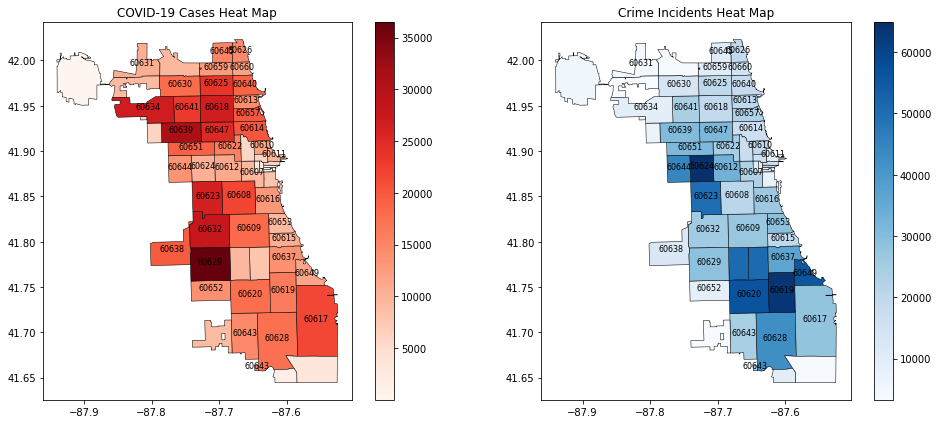

In [45]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Load shapefile data of Chicago or its neighborhoods into a GeoDataFrame
chicago_neighborhoods = gpd.read_file('geo_export_a6c18959-9216-4c17-a466-ecbb9f3d836f.shp')

# Aggregate COVID-19 cases by geographical units (e.g., zip codes or neighborhoods)
covid_agg = covid_weekly.groupby('zip_code')['cases_weekly'].sum().reset_index()

# Aggregate crime incidents by geographical units (e.g., zip codes or neighborhoods)
crime_agg = crime.groupby('Zip Code').size().reset_index(name='incidents')

# Merge the aggregated data with the GeoDataFrame
chicago_neighborhoods = chicago_neighborhoods.merge(covid_agg, left_on='zip', right_on='zip_code', how='left')
chicago_neighborhoods = chicago_neighborhoods.merge(crime_agg, left_on='zip', right_on='Zip Code', how='left')

# Sort the GeoDataFrame by the metric you want to use for labeling (e.g., COVID-19 cases)
chicago_neighborhoods_sorted = chicago_neighborhoods.sort_values(by='cases_weekly', ascending=False)

# Calculate the number of features to label (e.g., top 70%)
num_labels = int(len(chicago_neighborhoods_sorted) * 0.7)

# Plot heat maps for COVID-19 cases and crime incidents
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# Plot COVID-19 cases heat map
axes[0].set_title('COVID-19 Cases Heat Map')
chicago_neighborhoods.plot(column='cases_weekly', cmap='Reds', linewidth=0.5, ax=axes[0], edgecolor='black', legend=True)

# Annotate with zip codes for the top 70% by COVID-19 cases
for idx, row in chicago_neighborhoods_sorted.head(num_labels).iterrows():
    axes[0].annotate(text=row['zip_code'], xy=row['geometry'].centroid.coords[0], horizontalalignment='center', fontsize=8)

# Plot crime incidents heat map
axes[1].set_title('Crime Incidents Heat Map')
chicago_neighborhoods.plot(column='incidents', cmap='Blues', linewidth=0.5, ax=axes[1], edgecolor='black', legend=True)

for idx, row in chicago_neighborhoods_sorted.head(num_labels).iterrows():
    axes[1].annotate(text=row['Zip Code'], xy=row['geometry'].centroid.coords[0], horizontalalignment='center', fontsize=8)


plt.tight_layout()
plt.show()


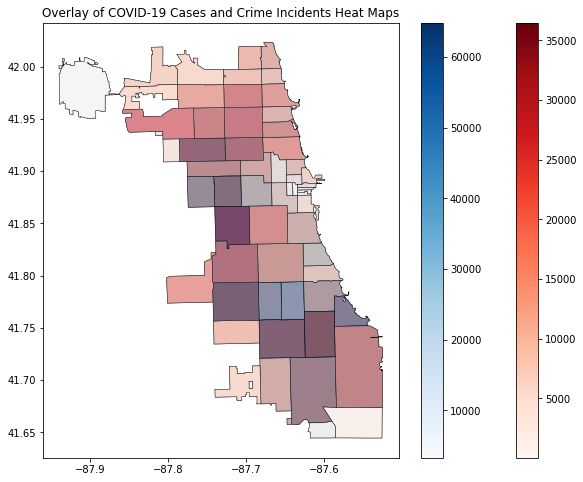

In [46]:


# Load shapefile data of Chicago or its neighborhoods into a GeoDataFrame
chicago_neighborhoods = gpd.read_file('geo_export_a6c18959-9216-4c17-a466-ecbb9f3d836f.shp')

# Aggregate COVID-19 cases by geographical units (e.g., zip codes or neighborhoods)
covid_agg = covid_weekly.groupby('zip_code')['cases_weekly'].sum().reset_index()

# Aggregate crime incidents by geographical units (e.g., zip codes or neighborhoods)
crime_agg = crime.groupby('Zip Code').size().reset_index(name='incidents')

# Merge the aggregated data with the GeoDataFrame
chicago_neighborhoods = chicago_neighborhoods.merge(covid_agg, left_on='zip', right_on='zip_code', how='left')
chicago_neighborhoods = chicago_neighborhoods.merge(crime_agg, left_on='zip', right_on='Zip Code', how='left')

# Plot both heat maps on the same set of axes
fig, ax = plt.subplots(figsize=(10, 8))

# Plot COVID-19 cases heat map
chicago_neighborhoods.plot(column='cases_weekly', cmap='Reds', linewidth=0.5, ax=ax, edgecolor='black', legend=True)

# Plot crime incidents heat map with transparency
chicago_neighborhoods.plot(column='incidents', cmap='Blues', linewidth=0.5, ax=ax, edgecolor='black', alpha=0.5, legend=True)

# Add titles
ax.set_title('Overlay of COVID-19 Cases and Crime Incidents Heat Maps')

plt.show()


### The Zip Code = '60623' seems to have both high covid-19 cases and high crime rates

### **Box Plots:** 
##### Used to compare the distributions of crime rates in neighborhoods with high and low COVID-19 cases. They can provide information about the median crime rate and any potential outliers

In [47]:
# high_covid_data

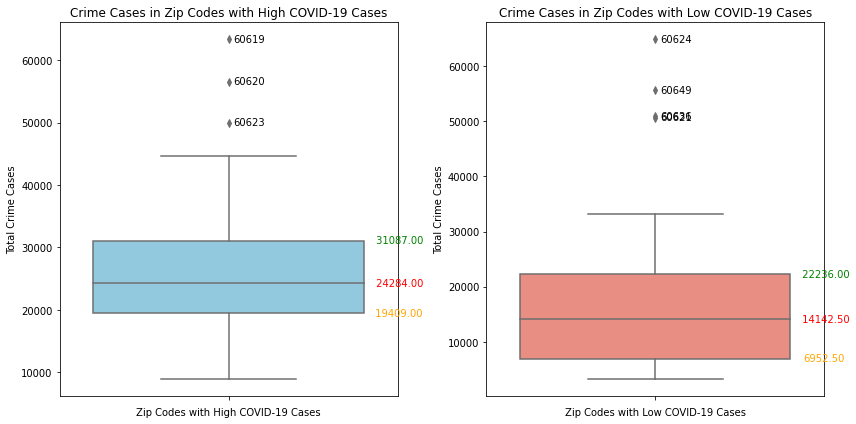

In [48]:
import seaborn as sns
import matplotlib.pyplot as plt

# Determine thresholds for high and low COVID-19 cases
covid_median = all_zip_codes['total_covid_count_for_zip'].median()
high_covid_zip = all_zip_codes[all_zip_codes['total_covid_count_for_zip'] > covid_median]['Zip Code']
low_covid_zip = all_zip_codes[all_zip_codes['total_covid_count_for_zip'] <= covid_median]['Zip Code']

# Subset data for high and low COVID-19 cases zip codes
high_covid_data = all_zip_codes[all_zip_codes['Zip Code'].isin(high_covid_zip)]
low_covid_data = all_zip_codes[all_zip_codes['Zip Code'].isin(low_covid_zip)]

# Set figure size
plt.figure(figsize=(12, 6))

# Create box plot for zip codes with high COVID-19 cases
plt.subplot(1, 2, 1)
ax1 = sns.boxplot(y=high_covid_data['total_crime_count_for_zip'], data=high_covid_data, color='skyblue')
plt.title('Crime Cases in Zip Codes with High COVID-19 Cases')
plt.xlabel('Zip Codes with High COVID-19 Cases')
plt.ylabel('Total Crime Cases')

# Annotate outlier points with their zip code values
outliers_high = high_covid_data[high_covid_data['total_crime_count_for_zip'] > high_covid_data['total_crime_count_for_zip'].quantile(0.75) + 1.5 * (high_covid_data['total_crime_count_for_zip'].quantile(0.75) - high_covid_data['total_crime_count_for_zip'].quantile(0.25))]
for index, row in outliers_high.iterrows():
    ax1.annotate(row['Zip Code'], (0, row['total_crime_count_for_zip']), xytext=(5,0), textcoords='offset points', va='center')

# Label median, 75th percentile, and 25th percentile
# ax1.axhline(high_covid_data['total_crime_count_for_zip'].median(), color='red', linestyle='--', label='Median')
# ax1.axhline(high_covid_data['total_crime_count_for_zip'].quantile(0.75), color='green', linestyle='--', label='75th Percentile')
# ax1.axhline(high_covid_data['total_crime_count_for_zip'].quantile(0.25), color='orange', linestyle='--', label='25th Percentile')
# ax1.legend()

# Add text for median, 75th percentile, and 25th percentile
plt.text(0.5, high_covid_data['total_crime_count_for_zip'].median(), f' {high_covid_data["total_crime_count_for_zip"].median():.2f}', horizontalalignment='center', verticalalignment='center', color='red')
plt.text(0.5, high_covid_data['total_crime_count_for_zip'].quantile(0.75), f' {high_covid_data["total_crime_count_for_zip"].quantile(0.75):.2f}', horizontalalignment='center', verticalalignment='center', color='green')
plt.text(0.5, high_covid_data['total_crime_count_for_zip'].quantile(0.25), f' {high_covid_data["total_crime_count_for_zip"].quantile(0.25):.2f}', horizontalalignment='center', verticalalignment='center', color='orange')

# Create box plot for zip codes with low COVID-19 cases
plt.subplot(1, 2, 2)
ax2 = sns.boxplot(y=low_covid_data['total_crime_count_for_zip'], data=low_covid_data, color='salmon')
plt.title('Crime Cases in Zip Codes with Low COVID-19 Cases')
plt.xlabel('Zip Codes with Low COVID-19 Cases')
plt.ylabel('Total Crime Cases')

# Annotate outlier points with their zip code values
outliers_low = low_covid_data[low_covid_data['total_crime_count_for_zip'] > low_covid_data['total_crime_count_for_zip'].quantile(0.75) + 1.5 * (low_covid_data['total_crime_count_for_zip'].quantile(0.75) - low_covid_data['total_crime_count_for_zip'].quantile(0.25))]
for index, row in outliers_low.iterrows():
    ax2.annotate(row['Zip Code'], (0, row['total_crime_count_for_zip']), xytext=(5,0), textcoords='offset points', va='center')

# Label median, 75th percentile, and 25th percentile
# ax2.axhline(low_covid_data['total_crime_count_for_zip'].median(), color='red', linestyle='--', label='Median')
# ax2.axhline(low_covid_data['total_crime_count_for_zip'].quantile(0.75), color='green', linestyle='--', label='75th Percentile')
# ax2.axhline(low_covid_data['total_crime_count_for_zip'].quantile(0.25), color='orange', linestyle='--', label='25th Percentile')
# ax2.legend()

# Add text for median, 75th percentile, and 25th percentile
plt.text(0.5, low_covid_data['total_crime_count_for_zip'].median(), f' {low_covid_data["total_crime_count_for_zip"].median():.2f}', horizontalalignment='center', verticalalignment='center', color='red')
plt.text(0.5, low_covid_data['total_crime_count_for_zip'].quantile(0.75), f' {low_covid_data["total_crime_count_for_zip"].quantile(0.75):.2f}', horizontalalignment='center', verticalalignment='center', color='green')
plt.text(0.5, low_covid_data['total_crime_count_for_zip'].quantile(0.25), f'{low_covid_data["total_crime_count_for_zip"].quantile(0.25):.2f}', horizontalalignment='center', verticalalignment='center', color='orange')

plt.tight_layout()
plt.show()


The outliers(Based on Zip Codes) present above with diamond shape icon, have very high number of crime cases, compared to the other Zip Codes of their respective high or low number of covid-cases category.

### **Time-Series Plot:**
##### Main visualization for visualizing the trends of COVID-19 cases and different types of crimes over time. It would allow you to see if there are any noticeable correlations or patterns between the two

#### Plot showing the change in total crimes and covid cases over weekly interval

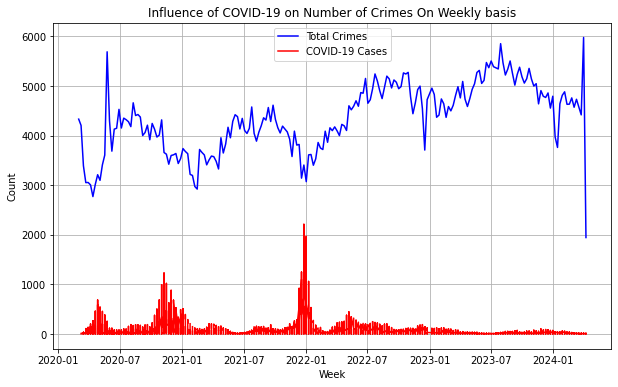

In [49]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming crime_df contains the crime data and covid_df contains the COVID-19 data

# Step 1: Aggregate the crime data to get the total number of crimes per week
crime_week_total = crime.groupby('week_start').size().reset_index(name='total_crimes')

# Step 2: Merge the COVID-19 data and the aggregated crime data based on the common week field
merged_df = pd.merge(crime_week_total, covid_weekly, left_on='week_start', right_on='week_start', how='inner')

# Step 3: Visualize the data using a time-series plot
plt.figure(figsize=(10, 6))
plt.plot(merged_df['week_start'], merged_df['total_crimes'], color='blue', label='Total Crimes')
plt.plot(merged_df['week_start'], merged_df['cases_weekly'], color='red', label='COVID-19 Cases')
plt.xlabel('Week')
plt.ylabel('Count')
plt.title('Influence of COVID-19 on Number of Crimes On Weekly basis')
plt.legend()
plt.grid(True)
plt.show()


#### Timeseries plot for each crime type on weekly cases using seaborn, matplotlib

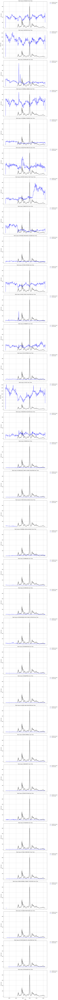

In [50]:
# Will take around 1 min. and 45 sec. to plot all graphs, can skip it and run the next cell to plot faster using plotly

import seaborn as sns
import matplotlib.pyplot as plt

# Aggregate crime data to calculate total cases for each primary type for each week
crime_agg = crime.groupby(['week_start', 'primary_type']).size().reset_index(name='total_cases')

# Get unique primary types
primary_types = crime_agg['primary_type'].unique()

# Create subplots for each primary type
fig, axes = plt.subplots(len(primary_types), 1, figsize=(12, 6 * len(primary_types)), sharex=True)

# Plot COVID-19 cases on each subplot
for ax in axes:
    sns.lineplot(data=covid_weekly, x='week_start', y='cases_weekly', ax=ax, label='COVID-19 Cases', color='black')

# Plot total cases for each primary type separately
for i, primary_type in enumerate(primary_types):
    ax = axes[i]
    sns.lineplot(data=crime_agg[crime_agg['primary_type'] == primary_type], x='week_start', y='total_cases', ax=ax, color='blue', label='Crime Cases')
    ax.set_xlabel('Date')
    ax.set_ylabel('Total Cases')
    ax.set_title(f'Total Cases of {primary_type} Over Time')
    ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')  # Adjust legend position if needed
    ax.grid(True)

plt.tight_layout()
plt.show()


In [51]:
covid = pd.read_csv('covid.csv')

#### Timeseries plot for weekly covid and crime cases using plotly library

In [52]:
import plotly.graph_objects as go

# Assuming you have aggregated crime data as 'crime_agg' and COVID-19 data as 'covid_weekly'

# Sort the COVID-19 data by week_start
covid_weekly_sorted = covid_weekly.sort_values(by='week_start')

# Create traces for COVID-19 cases
covid_trace = go.Scatter(x=covid_weekly_sorted['week_start'], y=covid_weekly_sorted['cases_weekly'], mode='lines', name='COVID-19 Cases')

# Create separate plots for each primary type
for primary_type in crime_agg['primary_type'].unique():
    filtered_data = crime_agg[crime_agg['primary_type'] == primary_type]
    crime_trace = go.Scatter(x=filtered_data['week_start'], y=filtered_data['total_cases'], mode='lines', name='Total Cases')
    fig = go.Figure(data=[covid_trace, crime_trace])
    fig.update_layout(
        title=f'Total Cases of {primary_type} Over Time',
        xaxis_title='Date',
        yaxis_title='Total Cases',
        legend_title='Legend',
        legend=dict(yanchor="top", y=0.99, xanchor="left", x=0.01),
        xaxis=dict(showgrid=True),
        yaxis=dict(showgrid=True),
    )
    fig.show()


In [53]:
crime_agg

,week_start,primary_type,total_cases
0,2018-06-17,ASSAULT,2
1,2018-06-17,BATTERY,15
2,2018-06-17,BURGLARY,2
3,2018-06-17,CRIMINAL DAMAGE,6
4,2018-06-17,CRIMINAL TRESPASS,1
...,...,...,...
7939,2024-04-07,ROBBERY,75
7940,2024-04-07,SEX OFFENSE,20
7941,2024-04-07,STALKING,2
7942,2024-04-07,THEFT,405


##### Line Plots for covid and different types of crime cases on weekly basis


In [54]:
import plotly.graph_objects as go
import pandas as pd

# Assume you have aggregated crime data as 'crime_agg' and COVID-19 data as 'covid_weekly'

# Sort the COVID-19 data by week_start
covid_weekly_sorted = covid_weekly.sort_values(by='week_start')

# Create traces for COVID-19 cases
covid_trace = go.Scatter(x=covid_weekly_sorted['week_start'], y=covid_weekly_sorted['cases_weekly'], mode='lines', name='COVID-19 Cases', line=dict(color='black'))

# Create traces for total cases of each primary type
crime_traces = []
for primary_type in crime_agg['primary_type'].unique():
    filtered_data = crime_agg[crime_agg['primary_type'] == primary_type]
    trace = go.Scatter(x=filtered_data['week_start'], y=filtered_data['total_cases'], mode='lines', name=primary_type)
    crime_traces.append(trace)

# Create the figure
fig = go.Figure(data=[covid_trace] + crime_traces)

# Add dropdown menu to remove specific feature lines
buttons = []
for i, primary_type in enumerate(crime_agg['primary_type'].unique()):
    visible = [False] * len(crime_agg['primary_type'].unique())
    visible[i] = True
    button = dict(label=primary_type, method='update', args=[{'visible': visible}, {'title': f'Total Cases of Each Primary Type of Crime Over Time ({primary_type} shown)'}])
    buttons.append(button)

fig.update_layout(updatemenus=[dict(type="buttons", direction="down", buttons=buttons)])

# Set layout
fig.update_layout(
    title='Total Cases of Each Primary Type of Crime Over Time',
    xaxis_title='Date',
    yaxis_title='Total Cases',
    legend_title='Primary Type',
    legend=dict(yanchor="top", y=0.99, xanchor="left", x=0.01),
    xaxis=dict(showgrid=True),
    yaxis=dict(showgrid=True),
)

fig.show()


In [55]:
crime_agg

,week_start,primary_type,total_cases
0,2018-06-17,ASSAULT,2
1,2018-06-17,BATTERY,15
2,2018-06-17,BURGLARY,2
3,2018-06-17,CRIMINAL DAMAGE,6
4,2018-06-17,CRIMINAL TRESPASS,1
...,...,...,...
7939,2024-04-07,ROBBERY,75
7940,2024-04-07,SEX OFFENSE,20
7941,2024-04-07,STALKING,2
7942,2024-04-07,THEFT,405


In [56]:
covid[:2]

,lab_report_date,cases_total,deaths_total,cases_age_0_17,cases_age_18_29,cases_age_30_39,cases_age_40_49,cases_age_50_59,cases_age_60_69,cases_age_70_79,cases_age_80_,cases_age_unknown,cases_female,cases_male,cases_unknown_gender,cases_latinx,cases_asian_non_latinx,cases_black_non_latinx,cases_white_non_latinx,cases_other_non_latinx,cases_unknown_race_eth,deaths_0_17_yrs,deaths_18_29_yrs,deaths_30_39_yrs,deaths_40_49_yrs,deaths_50_59_yrs,deaths_60_69_yrs,deaths_70_79_yrs,deaths_80_yrs,deaths_unknown_age,deaths_female,deaths_male,deaths_unknown_gender,deaths_latinx,deaths_asian_non_latinx,deaths_black_non_latinx,deaths_white_non_latinx,deaths_other_non_latinx,deaths_unknown_race_eth,hospitalizations_total,hospitalizations_age_0_17,hospitalizations_age_18_29,hospitalizations_age_30_39,hospitalizations_age_40_49,hospitalizations_age_50_59,hospitalizations_age_60_69,hospitalizations_age_70_79,hospitalizations_age_80_,hospitalizations_age_unknown,hospitalizations_female,hospitalizations_male,hospitalizations_unknown_gender,hospitalizations_latinx,hospitalizations_asian_non_latinx,hospitalizations_black_non_latinx,hospitalizations_white_non_latinx,hospitalizations_other_race_non_latinx,hospitalizations_unknown_race_ethnicity
0,2024-04-16T00:00:00.000,6,0,2,0,0,0,2,1,0,1,0,2,4,0,0,0,4,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2024-04-15T00:00:00.000,41,0,9,4,6,6,3,3,7,3,0,26,15,0,8,3,14,6,4,6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [57]:
# import plotly.graph_objs as go
# import plotly.io as pio

# # Convert datetime columns to a standard format without timezone information
# covid['lab_report_date'] = pd.to_datetime(covid['lab_report_date']).dt.tz_localize(None)
# crime_agg_date['date'] = pd.to_datetime(crime_agg_date['date']).dt.tz_localize(None)

# # Create traces for COVID-19 cases and total crime cases
# trace_covid = go.Scatter(x=covid['lab_report_date'], y=covid['cases_total'], mode='lines', name='COVID-19 Cases', line=dict(color='black'))
# trace_crime = go.Scatter(x=crime_agg_date['date'], y=crime_agg_date['total_cases'], mode='lines', name='Total Crime Cases', line=dict(color='blue'))

# # Create layout
# layout = go.Layout(
#     title='Total COVID-19 Cases vs Total Crime Cases Over Time On Daily Basis',
#     xaxis=dict(title='Date'),
#     yaxis=dict(title='Total Cases'),
#     legend=dict(x=1.05, y=1),
#     plot_bgcolor='rgba(0,0,0,0)'
# )

# # Create figure
# fig = go.Figure(data=[trace_covid, trace_crime], layout=layout)

# # Show plot
# pio.show(fig)


### Questions

##### Q-1: Did crime rates in Chicago increase or decrease during periods of high COVID-19 cases?

In [58]:
# Calculate mean and standard deviation
mean_cases = covid_weekly['cases_weekly'].mean()
std_dev_cases = covid_weekly['cases_weekly'].std()

# Set threshold as mean plus two standard deviations
threshold = mean_cases + 2 * std_dev_cases
# Identify periods of high COVID-19 cases (e.g., when weekly cases exceed a threshold)
high_covid_period = covid_weekly[covid_weekly['cases_weekly'] > threshold]


In [59]:
# Calculate total crimes per week
crime_weekly = crime.groupby('week_start').size().reset_index(name='total_crimes')

# Determine high COVID-19 periods
high_covid_periods = covid_weekly[covid_weekly['cases_weekly'] > threshold]
high_covid_weeks = high_covid_periods['week_start'].unique()

# Subset data for high COVID-19 periods and other periods
crime_high_covid = crime_weekly[crime_weekly['week_start'].isin(high_covid_weeks)]
crime_other_periods = crime_weekly[~crime_weekly['week_start'].isin(high_covid_weeks)]

# Calculate average crime rates for each group
average_crime_high_covid = crime_high_covid['total_crimes'].median()
average_crime_other_periods = crime_other_periods['total_crimes'].median()

# Perform statistical analysis
# Example using t-test
from scipy.stats import ttest_ind
t_stat, p_value = ttest_ind(crime_high_covid['total_crimes'], crime_other_periods['total_crimes'])
t_stat,p_value

(-6.775677386775391, 6.48634289768186e-11)

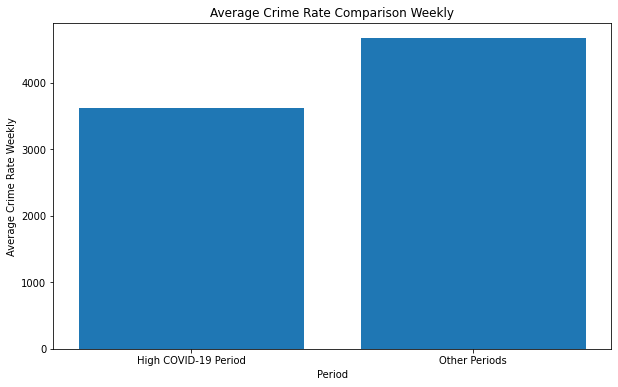

In [60]:
# Create visualizations
plt.figure(figsize=(10, 6))
plt.bar(['High COVID-19 Period', 'Other Periods'], [average_crime_high_covid, average_crime_other_periods])
plt.title('Average Crime Rate Comparison Weekly')
plt.xlabel('Period')
plt.ylabel('Average Crime Rate Weekly')
plt.show()


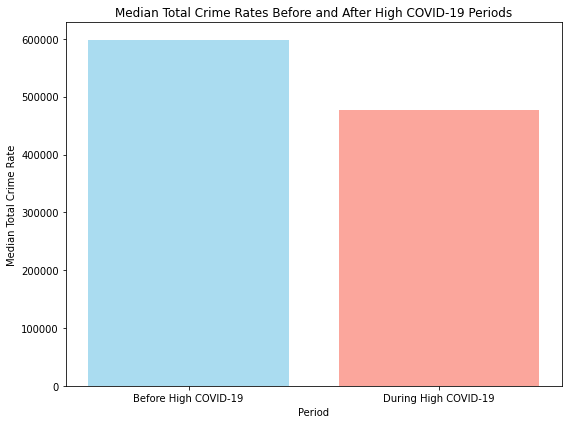

In [77]:
import pandas as pd
import matplotlib.pyplot as plt

# Aggregate total crime counts for each week
total_crime_weekly = crime.groupby('week_start')['this_week_crime_count_for_zip'].sum().reset_index()

# Aggregate COVID-19 cases by week
covid_weekly_agg = covid_weekly.groupby(pd.Grouper(key='week_start', freq='W'))['this_week_covid_count_for_zip'].sum().reset_index()

# Determine periods of high COVID-19 cases
covid_median = covid_weekly_agg['this_week_covid_count_for_zip'].median()
high_covid_periods = covid_weekly_agg[covid_weekly_agg['this_week_covid_count_for_zip'] > covid_median]

# Calculate median total crime rate before and after high COVID-19 periods
median_crime_before_high_covid = total_crime_weekly[total_crime_weekly['week_start'] < high_covid_periods['week_start'].min()]['this_week_crime_count_for_zip'].median()
median_crime_during_high_covid = total_crime_weekly[total_crime_weekly['week_start'] >= high_covid_periods['week_start'].min()]['this_week_crime_count_for_zip'].median()

# Plotting
plt.figure(figsize=(8, 6))

# Plot median crime rates before and after high COVID-19 periods
plt.bar(['Before High COVID-19', 'During High COVID-19'], [median_crime_before_high_covid, median_crime_during_high_covid], color=['skyblue', 'salmon'], alpha=0.7)

plt.title('Median Total Crime Rates Before and After High COVID-19 Periods')
plt.xlabel('Period')
plt.ylabel('Median Total Crime Rate')
plt.tight_layout()
plt.show()


##### From the graph, it's clearly visible that during high covid times median crime rates have decreased

#### Q-2: Did neighborhoods with higher COVID-19 cases experience different changes in crime rates compared to neighborhoods with lower COVID-19 cases?


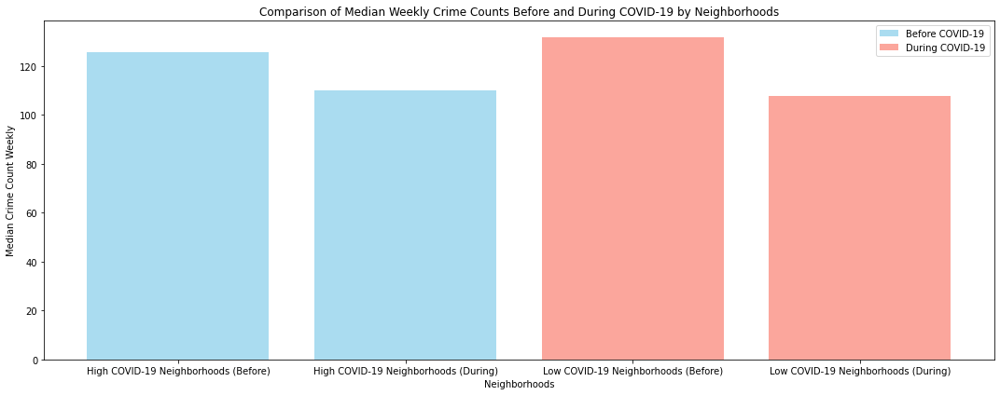

In [71]:
import pandas as pd
import matplotlib.pyplot as plt


# # Aggregate crime data by primary type
# crime_before_covid_agg = crime_before_covid.groupby('primary_type').size().reset_index(name='total_crime_count_before_covid')

# # Step 1: Aggregate COVID-19 cases and crime incidents by zip code
# covid_agg = covid_weekly.groupby('zip_code')['this_week_covid_count_for_zip'].median().reset_index()
# crime_agg = crime.groupby('Zip Code')['this_week_crime_count_for_zip'].median().reset_index()

# # Step 2: Determine neighborhoods with higher and lower COVID-19 cases
# covid_median = covid_agg['this_week_covid_count_for_zip'].median()
# high_covid_neighborhoods = covid_agg[covid_agg['this_week_covid_count_for_zip'] > covid_median]
# low_covid_neighborhoods = covid_agg[covid_agg['this_week_covid_count_for_zip'] <= covid_median]


# Assuming 'week_start' is a column in your 'crime' DataFrame representing the start of the week
# Filter crime data to include periods before and during COVID-19
crime_before_covid = crime[crime['week_start'] < '2020-03-02']
crime_during_covid = crime[crime['week_start'] >= '2020-03-02']

# Aggregate crime data by zip code for each period
crime_before_covid_agg = crime_before_covid.groupby('Zip Code')['this_week_crime_count_for_zip'].mean().reset_index(name='median_crime_count_before_covid')
crime_during_covid_agg = crime_during_covid.groupby('Zip Code')['this_week_crime_count_for_zip'].mean().reset_index(name='median_crime_count_during_covid')

# Aggregate COVID-19 cases by zip code
covid_agg = covid_weekly.groupby('zip_code')['this_week_covid_count_for_zip'].sum().reset_index()

# Determine neighborhoods with higher and lower COVID-19 cases
covid_median = covid_agg['this_week_covid_count_for_zip'].median()
high_covid_neighborhoods = covid_agg[covid_agg['this_week_covid_count_for_zip'] > covid_median]
low_covid_neighborhoods = covid_agg[covid_agg['this_week_covid_count_for_zip'] <= covid_median]

# Filter crime data for neighborhoods with high and low COVID-19 cases
crime_high_covid_before = crime_before_covid[crime_before_covid['Zip Code'].isin(high_covid_neighborhoods['zip_code'])]
crime_low_covid_before = crime_before_covid[crime_before_covid['Zip Code'].isin(low_covid_neighborhoods['zip_code'])]
crime_high_covid_during = crime_during_covid[crime_during_covid['Zip Code'].isin(high_covid_neighborhoods['zip_code'])]
crime_low_covid_during = crime_during_covid[crime_during_covid['Zip Code'].isin(low_covid_neighborhoods['zip_code'])]

# Aggregate crime data for neighborhoods with high and low COVID-19 cases during COVID-19 period
high_covid_median_crime_before = crime_high_covid_before['this_week_crime_count_for_zip'].mean()
low_covid_median_crime_before = crime_low_covid_before['this_week_crime_count_for_zip'].mean()
high_covid_median_crime_during = crime_high_covid_during['this_week_crime_count_for_zip'].mean()
low_covid_median_crime_during = crime_low_covid_during['this_week_crime_count_for_zip'].mean()

# Plotting
plt.figure(figsize=(15, 6))

# Plot median crimes before COVID-19
plt.bar(['High COVID-19 Neighborhoods (Before)', 'High COVID-19 Neighborhoods (During)'], [high_covid_median_crime_before, high_covid_median_crime_during], color='skyblue', alpha=0.7, label='Before COVID-19')

# Plot median crimes during COVID-19
plt.bar(['Low COVID-19 Neighborhoods (Before)', 'Low COVID-19 Neighborhoods (During)'], [low_covid_median_crime_before, low_covid_median_crime_during], color='salmon', alpha=0.7, label='During COVID-19')

plt.title('Comparison of Median Weekly Crime Counts Before and During COVID-19 by Neighborhoods')
plt.xlabel('Neighborhoods')
plt.ylabel('Median Crime Count Weekly')
plt.legend()
plt.tight_layout()
plt.show()


##### Q-3: Were there certain types of crime that were more prevalent during periods of high COVID-19 cases?


In [62]:
import pandas as pd

# Assuming 'week_start' is a column in your 'crime' DataFrame representing the start of the week
# Filter crime data to include periods during COVID-19
crime_during_covid = crime[crime['week_start'] >= '2020-03-02']

# Aggregate COVID-19 cases by week
covid_weekly_agg = covid_weekly.groupby(pd.Grouper(key='week_start', freq='W'))['this_week_covid_count_for_zip'].sum().reset_index()

# Determine the periods of high COVID-19 cases (for example, if it's above the median)
covid_median = covid_weekly_agg['this_week_covid_count_for_zip'].median()
high_covid_periods = covid_weekly_agg[covid_weekly_agg['this_week_covid_count_for_zip'] > covid_median]

# Create an empty DataFrame to store the results
crime_prevalence_during_high_covid = pd.DataFrame(columns=['Week Start', 'Primary Type', 'Prevalence'])

# Iterate through each high COVID-19 period
for index, period in high_covid_periods.iterrows():
    start_date = period['week_start']
    end_date = start_date + pd.DateOffset(days=6)  # Assuming a week consists of 7 days
    
    # Filter crime data for the current period
    crime_period = crime_during_covid[(crime_during_covid['week_start'] >= start_date) & (crime_during_covid['week_start'] <= end_date)]
    
    # Aggregate crime data by primary type and calculate prevalence
    crime_prevalence = crime_period['primary_type'].value_counts(normalize=True).reset_index()
    crime_prevalence.columns = ['Primary Type', 'Prevalence']
    
    # Add 'Week Start' column to the DataFrame
    crime_prevalence['Week Start'] = start_date
    
    # Append the results to the main DataFrame
    crime_prevalence_during_high_covid = pd.concat([crime_prevalence_during_high_covid, crime_prevalence], ignore_index=True)

# Calculate the median prevalence for each primary type of crime
median_prevalence = crime_prevalence_during_high_covid.groupby('Primary Type')['Prevalence'].median().reset_index()
median_prevalence.sort_values(by='Prevalence',ascending=False)

# Display the DataFrame
# print(crime_prevalence_during_high_covid)


,Primary Type,Prevalence
30,THEFT,0.211363
2,BATTERY,0.184704
5,CRIMINAL DAMAGE,0.117889
1,ASSAULT,0.090340
8,DECEPTIVE PRACTICE,0.067905
22,OTHER OFFENSE,0.059902
16,MOTOR VEHICLE THEFT,0.058346
31,WEAPONS VIOLATION,0.039974
27,ROBBERY,0.039009
3,BURGLARY,0.032617


#### From plots also, it can be seen that THEFT, BATTERY, CRIMINAL DAMAGE, etc. were still more prevalent during the covid time but their average weekly crime rate were decreased  

In [63]:
# import matplotlib.pyplot as plt

# # Step 1: Aggregate crime data by primary type and COVID-19 periods
# crime_primary_type_agg = crime.groupby(['primary_type', 'date'])['id'].count().reset_index()
# crime_primary_type_pivot = crime_primary_type_agg.pivot(index='primary_type', columns='date', values='id').fillna(0)

# # Step 2: Visualize the comparison of crime frequencies between high and low COVID-19 periods
# plt.figure(figsize=(10, 8))
# crime_primary_type_pivot.plot(kind='bar', stacked=True, color=['skyblue', 'salmon'])
# plt.title('Crime Frequencies During High and Low COVID-19 Periods')
# plt.xlabel('Crime Type')
# plt.ylabel('Frequency')
# plt.xticks(rotation=90)
# plt.legend(title='COVID-19 Period')
# plt.show()


In [64]:
covid_weekly

,zip_code,week_number,week_start,week_end,cases_weekly,cases_cumulative,case_rate_weekly,case_rate_cumulative,tests_weekly,tests_cumulative,test_rate_weekly,test_rate_cumulative,percent_tested_positive_weekly,percent_tested_positive_cumulative,deaths_weekly,deaths_cumulative,death_rate_weekly,death_rate_cumulative,population,row_id,zip_code_location,:@computed_region_rpca_8um6,:@computed_region_vrxf_vc4k,:@computed_region_6mkv_f3dw,:@computed_region_bdys_3d7i,:@computed_region_43wa_7qmu,longitude,latitude,total_covid_count_for_zip,this_week_covid_count_for_zip
0,60612,52,2021-12-26,2022-01-01,743.0,6287.0,2165.5,18323.6,3628.0,141906,10573.9,413587.5,0.219,0.052,2,83,5.8,241.9,34311,60612-2021-52,"{'type': 'Point', 'coordinates': [-87.687011, ...",28.0,29.0,21184.0,785.0,46.0,-87.687011,41.880040,11236.0,743.0
1,60612,1,2022-01-02,2022-01-08,603.0,6890.0,1757.5,20081.0,4423.0,146329,12890.9,426478.4,0.158,0.055,6,89,17.5,259.4,34311,60612-2022-1,"{'type': 'Point', 'coordinates': [-87.687011, ...",28.0,29.0,21184.0,785.0,46.0,-87.687011,41.880040,11236.0,603.0
2,60612,14,2022-04-03,2022-04-09,31.0,7670.0,90.4,22354.3,2121.0,181657,6181.7,529442.5,0.017,0.050,0,101,0.0,294.4,34311,60612-2022-14,"{'type': 'Point', 'coordinates': [-87.687011, ...",28.0,29.0,21184.0,785.0,46.0,-87.687011,41.880040,11236.0,31.0
3,60612,17,2022-04-24,2022-04-30,82.0,7852.0,239.0,22884.8,2427.0,187641,7073.5,546882.9,0.036,0.049,0,101,0.0,294.4,34311,60612-2022-17,"{'type': 'Point', 'coordinates': [-87.687011, ...",28.0,29.0,21184.0,785.0,46.0,-87.687011,41.880040,11236.0,82.0
4,60612,18,2022-05-01,2022-05-07,86.0,7938.0,250.6,23135.4,2426.0,190067,7070.6,553953.5,0.041,0.049,0,101,0.0,294.4,34311,60612-2022-18,"{'type': 'Point', 'coordinates': [-87.687011, ...",28.0,29.0,21184.0,785.0,46.0,-87.687011,41.880040,11236.0,86.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12621,60645,1,2023-12-31,2024-01-06,71.0,15117.0,148.7,31670.6,33.0,297712,69.1,623715.7,0.333,0.056,0,161,0.0,337.3,47732,60645-2023-1,"{'type': 'Point', 'coordinates': [-87.695049, ...",12.0,20.0,22528.0,42.0,27.0,-87.695049,42.008927,15357.0,71.0
12622,60646,1,2023-12-31,2024-01-06,24.0,9387.0,85.8,33540.6,16.0,156363,57.2,558698.7,0.313,0.068,1,106,3.6,378.7,27987,60646-2023-1,"{'type': 'Point', 'coordinates': [-87.761826, ...",18.0,12.0,22532.0,782.0,38.0,-87.761826,41.993931,9512.0,24.0
12623,60647,1,2023-12-31,2024-01-06,41.0,24925.0,46.9,28482.8,18.0,478684,20.6,547011.2,0.333,0.060,0,198,0.0,226.3,87509,60647-2023-1,"{'type': 'Point', 'coordinates': [-87.701101, ...",1.0,23.0,22535.0,322.0,41.0,-87.701101,41.921058,25113.0,41.0
12624,60707,1,2023-12-31,2024-01-06,14.0,6169.0,32.5,14340.2,NaN,4415,0.0,10262.9,0.000,0.129,0,67,0.0,155.7,43019,60707-2023-1,"{'type': 'Point', 'coordinates': [-87.808283, ...",NaN,NaN,4454.0,NaN,NaN,-87.808283,41.921777,6223.0,14.0


##### Q-4: How did the pandemic affect different types of crime (e.g., violent crimes, property crimes, etc.)?

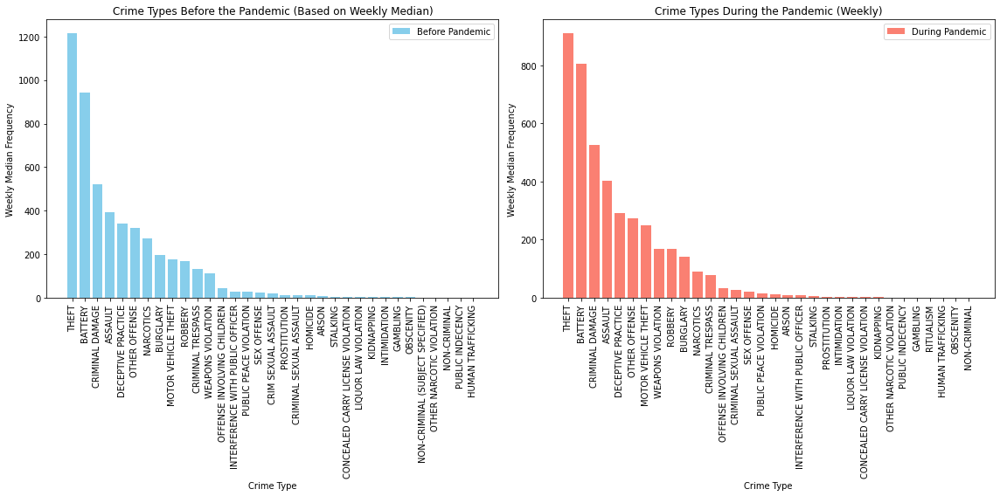

In [65]:
import matplotlib.pyplot as plt

# Aggregate crime data by crime type and time period
crime_before_pandemic = crime[crime['date'] < '2020-03-02']  # Date before the pandemic
crime_during_pandemic = crime[crime['date'] >= '2020-03-02']  # Date during the pandemic

crime_weekly_before = crime_before_pandemic.groupby(['primary_type', 'week_start']).size().reset_index(name='count')
crime_weekly_during = crime_during_pandemic.groupby(['primary_type', 'week_start']).size().reset_index(name='count')

# Calculate median number of incidents for each crime type
crime_before_median_weekly = crime_weekly_before.groupby('primary_type')['count'].median().reset_index(name='median_count_before')
crime_during_median_weekly = crime_weekly_during.groupby('primary_type')['count'].median().reset_index(name='median_count_during')

# Sort the aggregated data by median count
crime_before_median_weekly = crime_before_median_weekly.sort_values(by='median_count_before', ascending=False)
crime_during_median_weekly = crime_during_median_weekly.sort_values(by='median_count_during', ascending=False)


# Set up subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 8))

# Plot comparison for crime types before pandemic
axes[0].bar(crime_before_median_weekly['primary_type'], crime_before_median_weekly['median_count_before'], color='skyblue', label='Before Pandemic')
axes[0].set_title('Crime Types Before the Pandemic (Based on Weekly Median)')
axes[0].set_xlabel('Crime Type')
axes[0].set_ylabel('Weekly Median Frequency')
axes[0].tick_params(axis='x', rotation=90)
axes[0].legend()

# Plot comparison for crime types during pandemic
axes[1].bar(crime_during_median_weekly['primary_type'], crime_during_median_weekly['median_count_during'], color='salmon', label='During Pandemic')
axes[1].set_title('Crime Types During the Pandemic (Weekly)')
axes[1].set_xlabel('Crime Type')
axes[1].set_ylabel('Weekly Median Frequency')
axes[1].tick_params(axis='x', rotation=90)
axes[1].legend()

plt.tight_layout()
plt.show()


In [66]:
import plotly.graph_objects as go

# Create traces for each bar group
trace_before = go.Bar(
    x=crime_before_median_weekly['primary_type'],
    y=crime_before_median_weekly['median_count_before'],
    name='Before Pandemic',
    marker_color='skyblue'
)
trace_during = go.Bar(
    x=crime_during_median_weekly['primary_type'],
    y=crime_during_median_weekly['median_count_during'],
    name='During Pandemic',
    marker_color='salmon'
)

# Set up the layout
layout = go.Layout(
    title='Comparison of Crime Types Before and During the Pandemic (Based on Weekly Median)',
    xaxis=dict(title='Crime Type', tickangle=90),
    yaxis=dict(title='Weekly Median Frequency'),
    barmode='group',
    legend=dict(title='Period'),
    height=1000,  # Adjust height as needed
    width=1000   # Adjust width as needed
)

# Create figure
fig = go.Figure(data=[trace_before, trace_during], layout=layout)

# Show the figure
fig.show()


#### As shown above the crime rates for crime types like 'THEFT', 'BATTERY', 'DECEPTIVE PRACTICES', 'NARCOTICS', etc. got decreased during covid time but crimes like 'ASSAULT', 'CRIMINAL SEXUAL ASSAULT', 'MOTOR VEHICLE THEFT', 'WEAPONS VIOLATION', etc. seems increased during the covid times.

In [67]:
# Merge the median counts of crime types before and during the pandemic
crime_comparison = pd.merge(crime_before_median_weekly, crime_during_median_weekly, on='primary_type', suffixes=('_before', '_during'))

# Calculate the difference in median counts
crime_comparison['count_difference'] = crime_comparison['median_count_during'] - crime_comparison['median_count_before']

# Display the relations in numbers
crime_comparison.sort_values(by='count_difference',ascending=True)

#Shows weekly counts difference

,primary_type,median_count_before,median_count_during,count_difference
0,THEFT,1217.0,912.0,-305.0
6,NARCOTICS,274.0,91.0,-183.0
1,BATTERY,944.0,806.0,-138.0
7,BURGLARY,196.0,141.0,-55.0
10,CRIMINAL TRESPASS,131.0,79.0,-52.0
4,DECEPTIVE PRACTICE,340.0,291.0,-49.0
5,OTHER OFFENSE,320.0,274.0,-46.0
13,INTERFERENCE WITH PUBLIC OFFICER,27.0,8.0,-19.0
14,PUBLIC PEACE VIOLATION,26.0,14.0,-12.0
12,OFFENSE INVOLVING CHILDREN,43.0,33.0,-10.0


In [68]:
# ## Using Matplotlib




# import numpy as np
# import matplotlib.pyplot as plt


# # Find missing primary types in crime_before_median_weekly
# missing_types_before = set(crime_during_median_weekly['primary_type']) - set(crime_before_median_weekly['primary_type'])

# # Add missing primary types to crime_before_median_weekly with median_count_during set to 0
# for crime_type in missing_types_before:
#     crime_before_median_weekly = crime_before_median_weekly.append({'primary_type': crime_type, 'median_count_before': 0}, ignore_index=True)

# # Find missing primary types in crime_during_median_weekly
# missing_types_during = set(crime_before_median_weekly['primary_type']) - set(crime_during_median_weekly['primary_type'])

# # Add missing primary types to crime_during_median_weekly with median_count_during set to 0
# for crime_type in missing_types_during:
#     crime_during_median_weekly = crime_during_median_weekly.append({'primary_type': crime_type, 'median_count_during': 0}, ignore_index=True)

# # Sort both DataFrames by 'primary_type'
# # crime_before_median_weekly.sort_values(by='primary_type', inplace=True)
# # crime_during_median_weekly.sort_values(by='primary_type', inplace=True)
# crime_before_median_weekly.sort_values(by='median_count_before', ascending=False, inplace=True)
# crime_during_median_weekly.sort_values(by='median_count_during', ascending=False, inplace=True)


# # Set up subplots

# fig, axes = plt.subplots(figsize=(16, 8))

# # Get the number of crime types
# num_types = len(crime_before_median_weekly)

# # Set the width of each bar
# bar_width = 0.35

# # Calculate the positions of bars for each crime type
# indices = np.arange(num_types)
# bar_positions_before = indices - bar_width/2
# bar_positions_during = indices + bar_width/2

# # Plot comparison for crime types
# axes.bar(bar_positions_before, crime_before_median_weekly['median_count_before'], width=bar_width, color='skyblue', label='Before Pandemic')
# axes.bar(bar_positions_during, crime_during_median_weekly['median_count_during'], width=bar_width, color='salmon', label='During Pandemic')
# axes.set_title('Comparison of Crime Types Before and During the Pandemic (Based on Weekly Median)')
# axes.set_xlabel('Crime Type')
# axes.set_ylabel('Weekly Median Frequency')
# axes.set_xticks(indices)
# axes.set_xticklabels(crime_before_median_weekly['primary_type'], rotation=90)
# axes.legend()

# plt.tight_layout()
# plt.show()



In [69]:
crime_before_median_weekly

,primary_type,median_count_before
31,THEFT,1217.0
2,BATTERY,944.0
6,CRIMINAL DAMAGE,523.0
1,ASSAULT,393.0
9,DECEPTIVE PRACTICE,340.0
24,OTHER OFFENSE,320.0
18,NARCOTICS,274.0
3,BURGLARY,196.0
17,MOTOR VEHICLE THEFT,175.0
28,ROBBERY,167.0


In [70]:
crime_during_median_weekly

,primary_type,median_count_during
30,THEFT,912.0
2,BATTERY,806.0
5,CRIMINAL DAMAGE,527.0
1,ASSAULT,404.0
8,DECEPTIVE PRACTICE,291.0
22,OTHER OFFENSE,274.0
16,MOTOR VEHICLE THEFT,250.0
31,WEAPONS VIOLATION,168.0
27,ROBBERY,167.0
3,BURGLARY,141.0
